In [3]:
# !pip install torch torchvision matplotlib --quiet
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torchvision
from PIL import Image
import os, numpy as np, matplotlib.pyplot as plt

In [3]:
!wget -q https://www.cis.upenn.edu/~jshi/ped_html/PennFudanPed.zip
!unzip -q PennFudanPed.zip -d ./data

replace ./data/PennFudanPed/added-object-list.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


In [4]:
class PennFudanDataset(Dataset):
    def __init__(self, root, transform=None, S=7, B=2, C=1):
        self.root = root
        self.transform = transform
        self.imgs = list(sorted(os.listdir(os.path.join(root, "PNGImages"))))
        self.masks = list(sorted(os.listdir(os.path.join(root, "PedMasks"))))
        self.S, self.B, self.C = S, B, C

    def __len__(self):
        return len(self.imgs)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root, "PNGImages", self.imgs[idx])
        mask_path = os.path.join(self.root, "PedMasks", self.masks[idx])
        img = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path)

        # Extract bounding boxes from mask
        mask_np = np.array(mask)
        obj_ids = np.unique(mask_np)[1:]  # skip background 0
        boxes = []
        for obj_id in obj_ids:
            pos = np.where(mask_np == obj_id)
            xmin, xmax = np.min(pos[1]), np.max(pos[1])
            ymin, ymax = np.min(pos[0]), np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])

        # Convert to YOLO grid target
        label = torch.zeros((self.S, self.S, self.B*5 + self.C))
        w, h = img.size
        for box in boxes:
            x_c = (box[0] + box[2]) / (2 * w)
            y_c = (box[1] + box[3]) / (2 * h)
            bw = (box[2] - box[0]) / w
            bh = (box[3] - box[1]) / h
            cell_x, cell_y = int(x_c * self.S), int(y_c * self.S)
            label[cell_y, cell_x, 0:5] = torch.tensor([x_c, y_c, bw, bh, 1.0])
            label[cell_y, cell_x, 10:] = torch.tensor([1.0])  # pedestrian class

        if self.transform:
            img = self.transform(img)
        return img, label


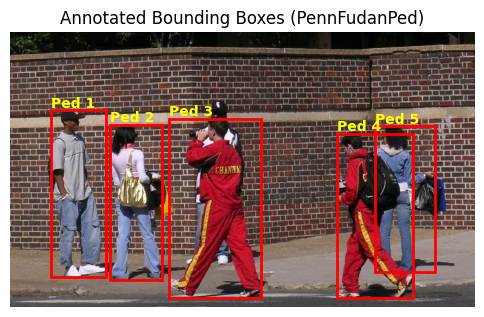

In [36]:
import matplotlib.patches as patches

root = "PennFudanPed"

# Select sample image and mask
img_path = os.path.join(root, "PNGImages", "PennPed00005.png")
mask_path = os.path.join(root, "PedMasks", "PennPed00005_mask.png")

# Load image and mask
img = np.array(Image.open(img_path).convert("RGB"))
mask = np.array(Image.open(mask_path))

# Extract unique object IDs (each pedestrian = different gray value)
obj_ids = np.unique(mask)[1:]  # skip background 0

# Plot image
fig, ax = plt.subplots(1, figsize=(6,6))
ax.imshow(img)

# Draw bounding boxes for each object
for obj_id in obj_ids:
    pos = np.where(mask == obj_id)
    xmin, xmax = np.min(pos[1]), np.max(pos[1])
    ymin, ymax = np.min(pos[0]), np.max(pos[0])

    rect = patches.Rectangle(
        (xmin, ymin), xmax - xmin, ymax - ymin,
        linewidth=2, edgecolor='r', facecolor='none'
    )
    ax.add_patch(rect)
    ax.text(xmin, ymin - 5, f"Ped {obj_id}", color='yellow', fontsize=10, weight='bold')

ax.set_title("Annotated Bounding Boxes (PennFudanPed)")
plt.axis("off")
plt.show()

In [14]:
class TinyYOLO(nn.Module):
    def __init__(self, S=7, B=2, C=1):
        super(TinyYOLO, self).__init__()
        self.S, self.B, self.C = S, B, C

        self.conv = nn.Sequential(
            nn.Conv2d(3, 16, 3, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.1),
            nn.MaxPool2d(2, 2),

            nn.Conv2d(16, 32, 3, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1),
            nn.MaxPool2d(2, 2),

            nn.Conv2d(32, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1),
            nn.MaxPool2d(2, 2),
        )

        # 64 * 32 * 32 = 65536 (for 256x256 input)
        self.fc = nn.Sequential(
            nn.Flatten(),
            nn.Linear(64 * 32 * 32, 4096),
            nn.LeakyReLU(0.1),
            nn.Linear(4096, S * S * (B * 5 + C))
        )

    def forward(self, x):
        x = self.conv(x)
        x = self.fc(x)
        return x.view(-1, self.S, self.S, self.B * 5 + self.C)


In [15]:
class YoloLoss(nn.Module):
    def __init__(self, S=7, B=2, C=1, λ_coord=5, λ_noobj=0.5):
        super(YoloLoss, self).__init__()
        self.S, self.B, self.C = S, B, C
        self.λ_coord, self.λ_noobj = λ_coord, λ_noobj

    def forward(self, preds, targets):
        coord_mask = targets[..., 4] > 0

        loc_loss = F.mse_loss(preds[..., 0:2][coord_mask], targets[..., 0:2][coord_mask])
        size_loss = F.mse_loss(torch.sqrt(torch.abs(preds[..., 2:4][coord_mask])),
                               torch.sqrt(torch.abs(targets[..., 2:4][coord_mask])))
        conf_loss_obj = F.mse_loss(preds[..., 4][coord_mask], targets[..., 4][coord_mask])
        conf_loss_noobj = F.mse_loss(preds[..., 4][~coord_mask], targets[..., 4][~coord_mask])
        class_loss = F.mse_loss(preds[..., 10:], targets[..., 10:])

        total_loss = (self.λ_coord * (loc_loss + size_loss)
                      + conf_loss_obj
                      + self.λ_noobj * conf_loss_noobj
                      + class_loss)
        return total_loss


In [41]:
S, B, C = 7, 2, 1
transform = transforms.Compose([transforms.Resize((256,256)), transforms.ToTensor()])
dataset = PennFudanDataset(root='PennFudanPed', transform=transform, S=S, B=B, C=C)
loader = DataLoader(dataset, batch_size=4, shuffle=True)

model = TinyYOLO(S=S, B=B, C=C)
criterion = YoloLoss(S=S, B=B, C=C)
optimizer = optim.Adam(model.parameters(), lr=1e-4)

n_epochs = 2
for epoch in range(n_epochs):
    total_loss = 0
    for imgs, labels in loader:
        preds = model(imgs)
        loss = criterion(preds, labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    print(f"Epoch [{epoch+1}/{n_epochs}] | Loss: {total_loss/len(loader):.4f}")


Epoch [1/2] | Loss: 74.9012
Epoch [2/2] | Loss: 27.0815


170


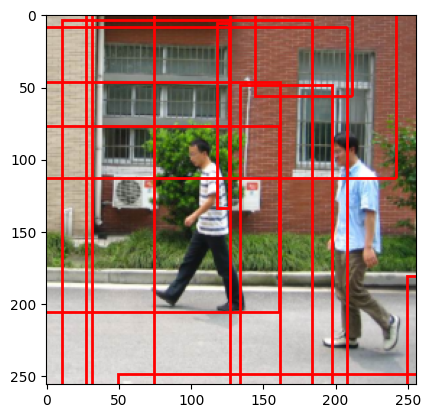

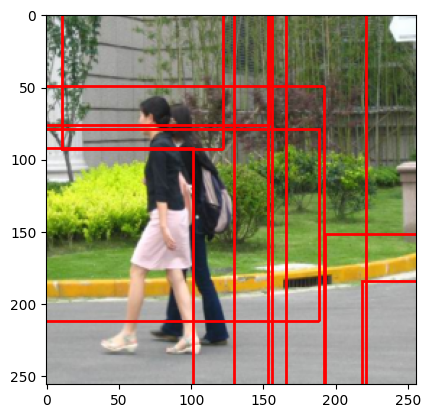

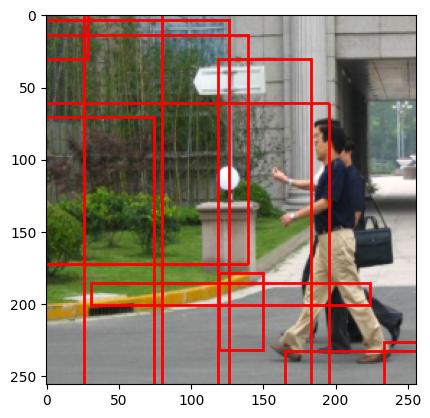

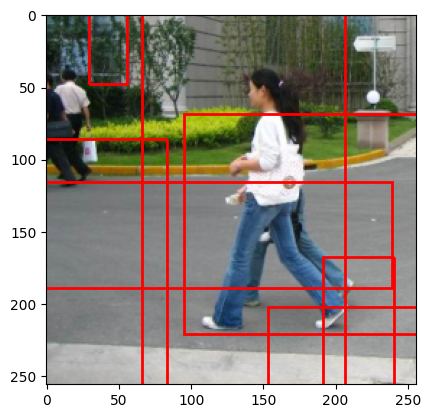

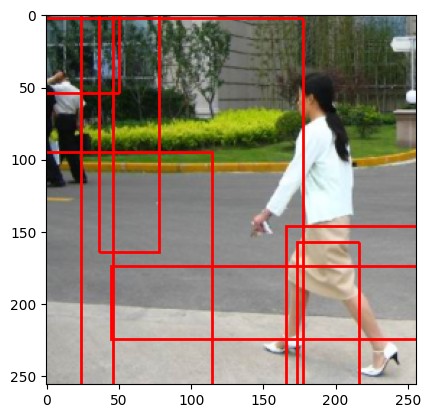

...

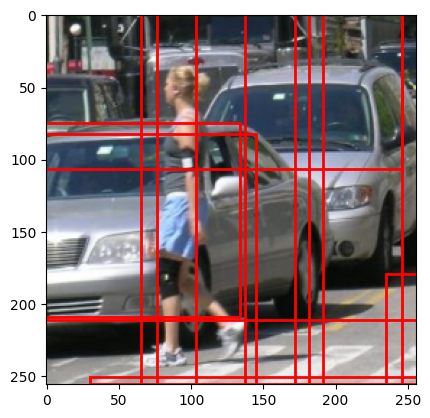

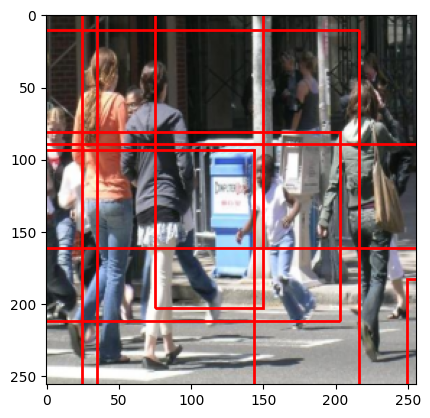

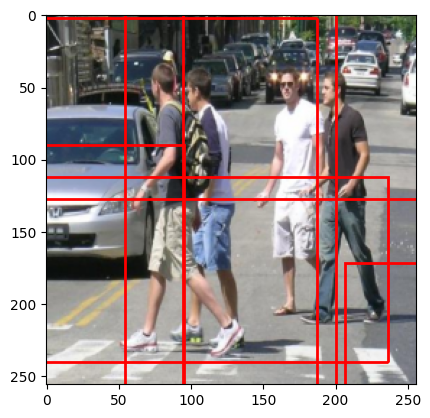

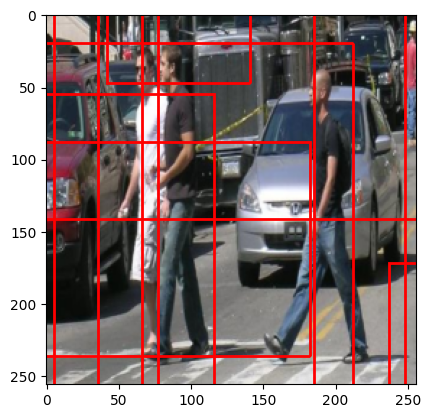

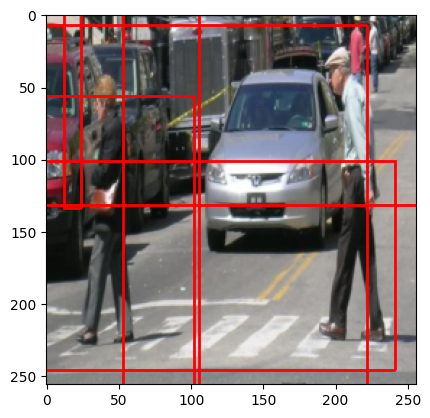

In [ ]:
import matplotlib.patches as patches

def plot_prediction(img, pred, S=7, conf_thresh=0.3):
    fig, ax = plt.subplots(1)
    ax.imshow(np.transpose(img.numpy(), (1,2,0)))
    cell_size = 1/S
    for i in range(S):
        for j in range(S):
            if pred[0, i, j, 4] > conf_thresh:
                x, y, w, h = pred[0, i, j, 0:4]
                x, y, w, h = float(x), float(y), float(w), float(h)
                rect = patches.Rectangle(((x - w/2)*256, (y - h/2)*256),
                                         w*256, h*256, linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)
    plt.show()

print(len(dataset))
for i in range(170):
    test_img, _ = dataset[i]
    with torch.no_grad():
        pred = model(test_img.unsqueeze(0))
    plot_prediction(test_img, pred)